In [1]:
%matplotlib inline


Transfer Learning for Computer
==============================================
**Reference**: `Sasank Chilamkurthy <https://chsasank.github.io>`_

These two major transfer learning scenarios look as follows:

-  **Finetuning the convnet**: Instead of random initializaion, we
   initialize the network with a pretrained network, like the one that is
   trained on imagenet 1000 dataset. The rest of the training looks as
   usual.
-  **ConvNet as fixed feature extractor**: Here, we will freeze the weights
   for all of the network except that of the final fully connected
   layer. This last fully connected layer is replaced with a new one
   with random weights and only this layer is trained.




In [2]:
# License: BSD
# Author: Ghassen Hamrouni

from __future__ import print_function
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torchvision import datasets, transforms, models
import matplotlib.pyplot as plt
import numpy as np
import os
from myImageFolder import MyImageFolder
import time
from sklearn import metrics
import copy
import pandas as pd
from PIL import Image, ImageDraw
from skimage.measure import label
import matplotlib.patches as patches

plt.ion()   # interactive mode

Load Data
---------

We will use torchvision and torch.utils.data packages for loading the
data.


In [3]:
# with data augmentation
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.RandomRotation(10),
        transforms.ColorJitter(0.2,0.2,0.2),
        transforms.RandomAffine(degrees=2, translate=(0.15,0.1),scale=(0.75,1.05)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),
    'val': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),
    'test': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),


}

data_dir = '/home/kaiyihuang/nexperia/new_data'
image_datasets = {x: MyImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val', 'test']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=32,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val', 'test']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val', 'test']}
class_names = image_datasets['train'].classes

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [104]:
# obtain bounding boxes
defect_details = pd.DataFrame(columns=['label', 'defect_1', 'defect_2', 'shape', 'x_1', 'y_1', 'x_2', 'y_2'])
for defect in image_datasets['test'].classes:
    if defect in ['chipping', 'lead_defect', 'foreign_material', 'pocket_damage', 'lead_glue', 'marking_defect', 'scratch']:
        file_name = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', defect,
                                 'ImageLabel.csv')
        table = pd.read_csv(file_name, names=['label', 'defect_2', 'shape', 'x_1', 'y_1', 'x_2', 'y_2'])
        table['defect_1'] = defect
        defect_details = defect_details.append(table)

defect_details = defect_details.set_index(['defect_1', 'label'])

Visualize a few images
^^^^^^^^^^^^^^^^^^^^^^
Let's visualize a few training images so as to understand the data
augmentations.



In [11]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.figure(figsize=(30,20))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

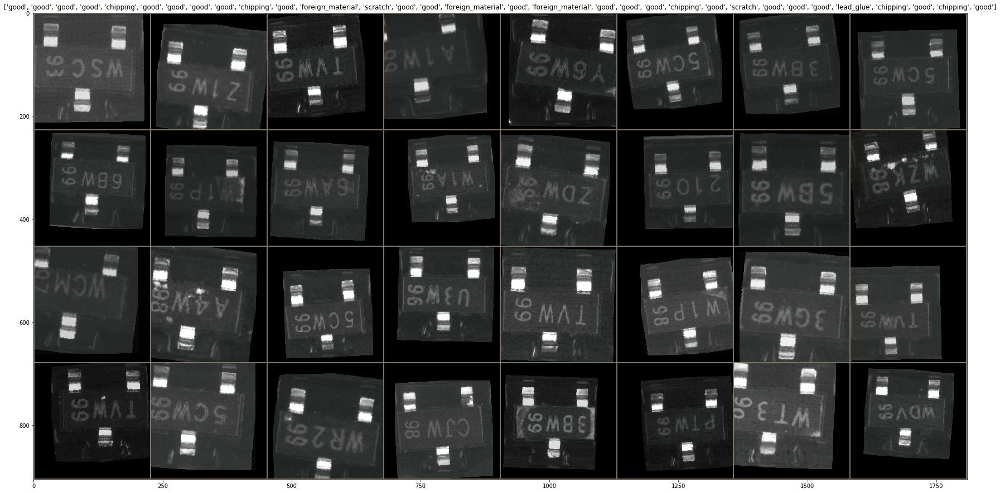

In [12]:
# Get a batch of training data
inputs, classes, image_id = next(iter(dataloaders['train']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title=[class_names[x] for x in classes])

Finetuning the convnet
----------------------

Load a pretrained model and reset final fully connected layer.




In [6]:
model_ft = models.vgg19_bn(pretrained=True)
num_ftrs = model_ft.classifier[6].in_features
# Here the size of each output sample is set to 10.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
model_ft.classifier[6] = nn.Linear(num_ftrs, 10)

model = model_ft.to(device)

In [8]:
print(model)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 256

Training the model
------------------

Now, let's write a general function to train a model. Here, we will
illustrate:

-  Scheduling the learning rate
-  Saving the best model

In the following, parameter ``scheduler`` is an LR scheduler object from
``torch.optim.lr_scheduler``.



In [24]:
def train(epoch, model):    
    model.train()
    train_loss = 0
    y_true = []
    y_score = []
    image_ids = []
    for batch_idx, (data, target, image_id) in enumerate(dataloaders['train']):
        data, target = data.to(device), target.to(device)

        optimizer.zero_grad()
        output = model(data)
        loss = F.cross_entropy(output, target)
        loss.backward()
        optimizer.step()
        train_loss += loss * len(target)
        
        probs = F.softmax(output, dim=1)
        
        y_true.append(target.detach().to('cpu'))
        y_score.append(probs.detach().to('cpu'))
        image_ids.append(image_id)
        
    train_loss /= len(image_datasets['train'])
    
    y_true = torch.cat(y_true)
    y_score = torch.cat(y_score)

    auc = metrics.roc_auc_score(y_true!=4, 1.-y_score[:,4])
    
    print('Train Epoch{} - Average Loss: {:.6f}, AUC: {:.4f}%'.format(
        epoch, train_loss.item(), auc*100.))
    return train_loss.item(), auc, model

def eval_train_data(model):    
    model.eval()
    train_loss = 0
    y_true = []
    y_score = []
    image_ids = []
    for batch_idx, (data, target, image_id) in enumerate(dataloaders['train']):
        data, target = data.to(device), target.to(device)

        optimizer.zero_grad()
        output = model(data)
        loss = F.cross_entropy(output, target)
        loss.backward()
        optimizer.step()
        train_loss += loss * len(target)
        
        probs = F.softmax(output, dim=1)
        
        y_true.append(target.detach().to('cpu'))
        y_score.append(probs.detach().to('cpu'))
        image_ids.append(image_id)
        
    train_loss /= len(image_datasets['train'])
    
    y_true = torch.cat(y_true)
    y_score = torch.cat(y_score)

    auc = metrics.roc_auc_score(y_true!=4, 1.-y_score[:,4])

    print('Train average Loss: {:.6f}, AUC: {:.4f}%'.format(
        train_loss.item(), auc*100.))
    return y_true, y_score, image_ids, train_loss.item(), auc

def test(model):
    with torch.no_grad():
        model.eval()
        test_loss = 0
        correct = 0
        y_true = []
        y_score = []
        image_ids = []
        for data, target, image_id in dataloaders['test']:
            data, target = data.to(device), target.to(device)-1
            output = model(data)

            # sum up batch loss
            test_loss += F.cross_entropy(output, target, reduction='sum').item()
            
            probs = F.softmax(output, dim=1)
            
            y_true.append(target.detach().to('cpu'))
            y_score.append(probs.detach().to('cpu'))
            image_ids.append(image_id)

        test_loss /= len(image_datasets['test'])
        
        y_true = torch.cat(y_true)
        y_score = torch.cat(y_score)
                
        auc = metrics.roc_auc_score(y_true!=4, 1.-y_score[:,4])

        print('Test set - Average loss: {:.4f}, AUC: {:.4f}%'
              .format(test_loss, auc*100.))
        return y_true, y_score, image_ids, auc, test_loss

def val(model):
    with torch.no_grad():
        model.eval()
        val_loss = 0
        correct = 0
        y_true = []
        y_score = []
        image_ids = []
        for data, target, image_id in dataloaders['val']:
            data, target = data.to(device), target.to(device)
            output = model(data)

            # sum up batch loss
            val_loss += F.cross_entropy(output, target, reduction='sum').item()
            
            probs = F.softmax(output, dim=1)
            
            y_true.append(target.detach().to('cpu'))
            y_score.append(probs.detach().to('cpu'))
            image_ids.append(image_id)

        val_loss /= len(image_datasets['val'])
                
        y_true = torch.cat(y_true)
        y_score = torch.cat(y_score)
        
        auc = metrics.roc_auc_score(y_true!=4, 1.-y_score[:,4])

        print('Val set - Average loss: {:.4f}, AUC: {:.4f}%\n'
              .format(val_loss, auc*100.))
        return y_true, y_score, image_ids, auc, val_loss

In [7]:
# batch_size=32, with data augmentation
optimizer = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

exp_lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

since = time.time()

best_model_wts = copy.deepcopy(model.state_dict())
best_auc = 0
best_epoch = 0
train_losses = []
val_losses = []
train_aucs = []
val_aucs = []

for epoch in range(1, 50 + 1):
    train_loss, train_auc, model = train(epoch, model)
    exp_lr_scheduler.step()
    y_true, y_score, image_id, val_auc, val_loss = val(model)
    
    train_losses.append(train_loss)
    train_aucs.append(train_auc)
    val_losses.append(val_loss)
    val_aucs.append(val_auc)
        
    if val_auc > best_auc:
        best_model_wts = copy.deepcopy(model.state_dict())
        best_epoch = epoch
        best_y_true, best_y_score, best_image_id, best_auc = y_true, y_score, image_id, val_auc

time_elapsed = time.time() - since
print('Training complete in {:.0f}m {:.0f}s'.format(
    time_elapsed // 60, time_elapsed % 60))
print('Best epoch: {:d}'.format(best_epoch))
print('Best AUC: {:4f}%'.format(best_auc*100))

Train Epoch1 - Average Loss: 0.366024, AUC: 96.4660%
Val set - Average loss: 0.1634, AUC: 99.6325%

Train Epoch2 - Average Loss: 0.177438, AUC: 99.3336%
Val set - Average loss: 0.1316, AUC: 99.7631%

Train Epoch3 - Average Loss: 0.139369, AUC: 99.6316%
Val set - Average loss: 0.1237, AUC: 99.8099%

Train Epoch4 - Average Loss: 0.118197, AUC: 99.7365%
Val set - Average loss: 0.1366, AUC: 99.8497%

Train Epoch5 - Average Loss: 0.103699, AUC: 99.8135%
Val set - Average loss: 0.1287, AUC: 99.8447%

Train Epoch6 - Average Loss: 0.093441, AUC: 99.8542%
Val set - Average loss: 0.1175, AUC: 99.8486%

Train Epoch7 - Average Loss: 0.082681, AUC: 99.8975%
Val set - Average loss: 0.1089, AUC: 99.8482%

Train Epoch8 - Average Loss: 0.060495, AUC: 99.9556%
Val set - Average loss: 0.1074, AUC: 99.8806%

Train Epoch9 - Average Loss: 0.055970, AUC: 99.9594%
Val set - Average loss: 0.1092, AUC: 99.8726%

Train Epoch10 - Average Loss: 0.055058, AUC: 99.9593%
Val set - Average loss: 0.1092, AUC: 99.8690%


Save model
---------------------------

In [8]:
torch.save({'model_state_dict': best_model_wts,
            'best_auc': best_auc,
            'train_loss': train_losses,
            'val_loss': val_losses,
            'train_auc': train_aucs,
            'val_auc': val_aucs,
            
           }, 'vgg19_bn_augment_sgd_lr_001_momentum_9_stepsize_14_gamma_1_epoch_50_batch_size_32.pt')

load model
---------------------------

In [8]:
state_dict = torch.load('vgg19_bn_augment_sgd_lr_001_momentum_9_stepsize_14_gamma_1_epoch_50_batch_size_32.pt')

In [9]:
best_model_wts = state_dict['model_state_dict']

In [10]:
model.load_state_dict(best_model_wts)

<All keys matched successfully>

ROC curve
---------------------------

In [25]:
# vgg19_bn_augment_sgd_lr_001_momentum_9_stepsize_14_gamma_1_epoch_50_batch_size_32
y_true, y_score, image_id, auc, loss = test(model)
fpr, tpr, thr = metrics.roc_curve(y_true!=4, 1-y_score[:,4])
fpr_991 = fpr[tpr>=0.991][0]
fpr_993 = fpr[tpr>=0.993][0]
fpr_995 = fpr[tpr>=0.995][0]
fpr_997 = fpr[tpr>=0.997][0]
fpr_1 = fpr[tpr>=1][0]
print(fpr_991)
print(fpr_993)
print(fpr_995)
print(fpr_997)
print(fpr_1)

Test set - Average loss: 0.1087, AUC: 99.6952%
0.02817824377457405
0.029161205766710354
0.062254259501965926
0.08846657929226737
0.8666448230668414


In [27]:
image_id_test = np.array(list(sum(image_id, ())))

In [28]:
image_id_test.shape

(3830,)

In [19]:
image_id_dict = {}
for i in range(10):
    idx = np.where(y_true==i)[0]
    sort = torch.argsort(y_score[idx,i],descending=True)
    if len(idx)<=60:
        image_id_dict[class_names[i]+'_id'] = image_id_test[idx[sort]]
        image_id_dict[class_names[i]+'_score'] = y_score[idx[sort]]
        print(i, class_names[i], len(sort))
    else:
        high_idx = idx[sort][:30]
        low_idx = idx[sort][-30:]
        image_id_dict[class_names[i]+'_high_id'] = image_id_test[high_idx]
        image_id_dict[class_names[i]+'_low_id'] = image_id_test[low_idx]
        image_id_dict[class_names[i]+'_high_score'] = y_score[high_idx]
        image_id_dict[class_names[i]+'_low_score'] = y_score[low_idx]
idx = np.where(y_true!=4)[0]
sort = torch.argsort(y_score[idx,4], descending=True)
bad_low_idx = idx[sort][:30]
image_id_dict['bad_low_id'] = image_id_test[bad_low_idx]
image_id_dict['bad_low_score'] = y_score[bad_low_idx]
image_id_dict['bad_low_class'] = y_true[bad_low_idx]

1 device_flip 14
2 empty_pocket 20
5 lead_defect 25
7 marking_defect 18
8 pocket_damage 1


In [155]:
state_dict['test_result'] = image_id_dict

In [157]:
torch.save(state_dict, 'vgg19_bn_augment_sgd_lr_001_momentum_9_stepsize_14_gamma_1_epoch_50_batch_size_32.pt')

CAM
------

In [73]:
a = nn.Sequential(*list(model.children())[:-2])

In [72]:
a = torch.rand(1,2,3,3)
b = nn.Linear(18,4)
torch.autograd.functional.jacobian(b,a.view(1,-1)).squeeze().view(4,2,3,3).mean(dim=(1,2))

tensor([[-0.0142, -0.0216,  0.0258],
        [-0.0210, -0.0242, -0.0291],
        [-0.0879,  0.0819,  0.0710],
        [-0.0175,  0.0139, -0.0724]])

In [75]:
a(torch.rand(1,3,224,224).to(device)).squeeze().shape

torch.Size([512, 7, 7])

In [127]:
def im(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0)) # The input is CXHXW, the output is HXWXC
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    return inp
            
def plot_cam(model, image_path):
    
    img = Image.open(image_path).convert('RGB')# note that this was a grayscale image
    img_tensor = data_transforms['val'](img).view(1,3,224,224).to(device)
    vgg_conv = nn.Sequential(*list(model.children()))[:-2]
    vgg_fc = nn.Sequential(*list(model.children()))[-1]
    
    # define the operation of upsampling to the image size
    m = nn.Upsample(size=(224,224), mode='bilinear') 
    
    m = m.to(device) 
    img_tensor = img_tensor.to(device)
        
    last_conv_output = vgg_conv(img_tensor)
    
    alpha = torch.autograd.functional.jacobian(vgg_fc,last_conv_output.view(1,-1)).squeeze().view(10,512,7,7).mean(dim=(2,3)) # (10*512)
    act_maps = torch.matmul(last_conv_output.permute(0,2,3,1),alpha.T).permute(0,3,1,2)
    out = m(act_maps)

    return torch.squeeze(out)

In [79]:
class_names = class_names[1:]

In [82]:
image_id_dict = {}
for i in range(10):
    idx = np.where(y_true==i)[0]
    sort = torch.argsort(y_score[idx,i],descending=True)
    if len(idx)<=60:
        image_id_dict[class_names[i]+'_id'] = image_id_test[idx[sort]]
        image_id_dict[class_names[i]+'_score'] = y_score[idx[sort]]
        print(i, class_names[i], len(sort))
    else:
        high_idx = idx[sort][:30]
        low_idx = idx[sort][-30:]
        image_id_dict[class_names[i]+'_high_id'] = image_id_test[high_idx]
        image_id_dict[class_names[i]+'_low_id'] = image_id_test[low_idx]
        image_id_dict[class_names[i]+'_high_score'] = y_score[high_idx]
        image_id_dict[class_names[i]+'_low_score'] = y_score[low_idx]
idx = np.where(y_true!=4)[0]
sort = torch.argsort(y_score[idx,4], descending=True)
bad_low_idx = idx[sort][:30]
image_id_dict['bad_low_id'] = image_id_test[bad_low_idx]
image_id_dict['bad_low_score'] = y_score[bad_low_idx]
image_id_dict['bad_low_class'] = y_true[bad_low_idx]

1 device_flip 14
2 empty_pocket 20
5 lead_defect 25
7 marking_defect 18
8 pocket_damage 1


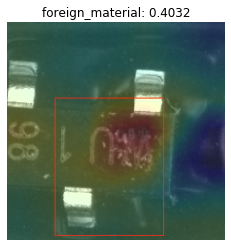

In [128]:
# trained without data augmentation
# pocket damge

defect = 8
    
image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id']+'.bmp')
img = Image.open(image_path).convert('RGB')
x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_id'])][['x_1', 'y_1', 'x_2', 'y_2']]
img = Image.open(image_path).convert('RGB')
draw = ImageDraw.Draw(img)
draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
img = data_transforms['test'](img)
out = plot_cam(model, image_path)
plt.imshow(im(img))
plt.imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
plt.title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'])], torch.max(image_id_dict[class_names[defect]+'_score'])))
plt.axis('off')
plt.show()

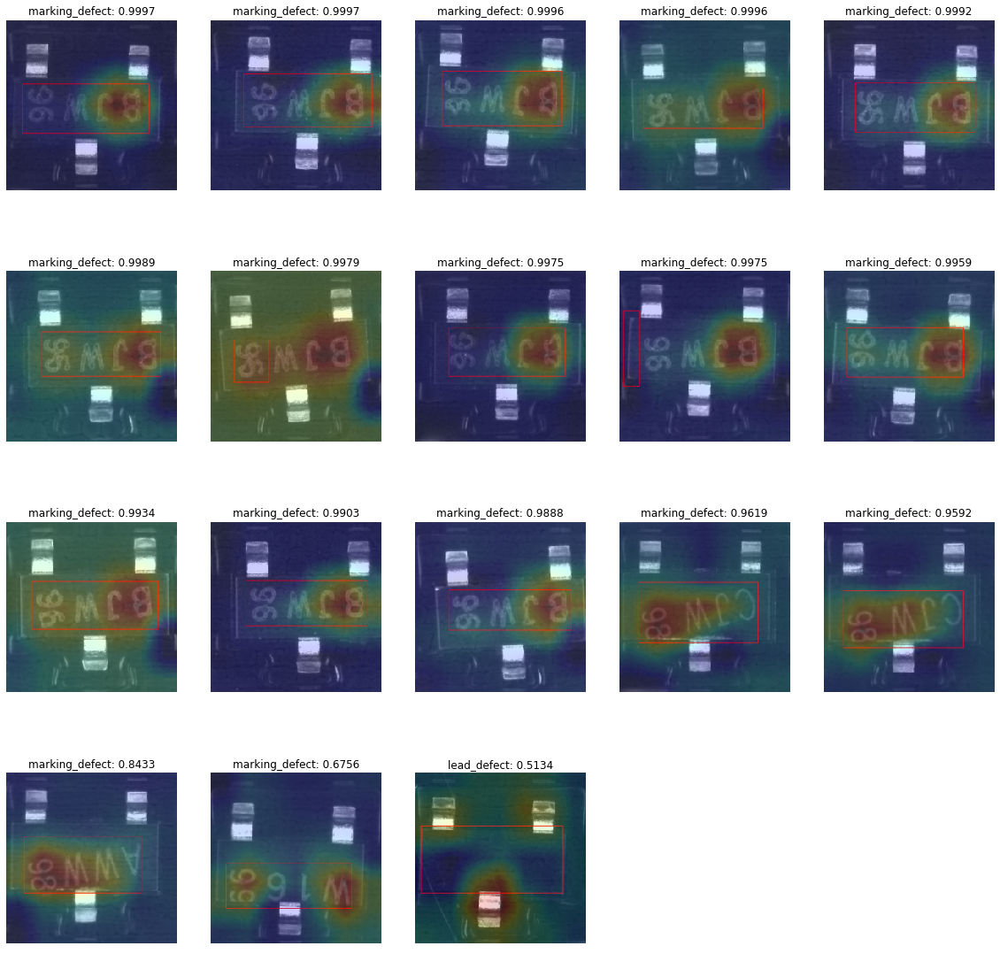

In [129]:
# marking defect

defect = 7

fig, axs = plt.subplots(4, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(18):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')
    
for i in range(18,20):
    axs[i].axis('off')

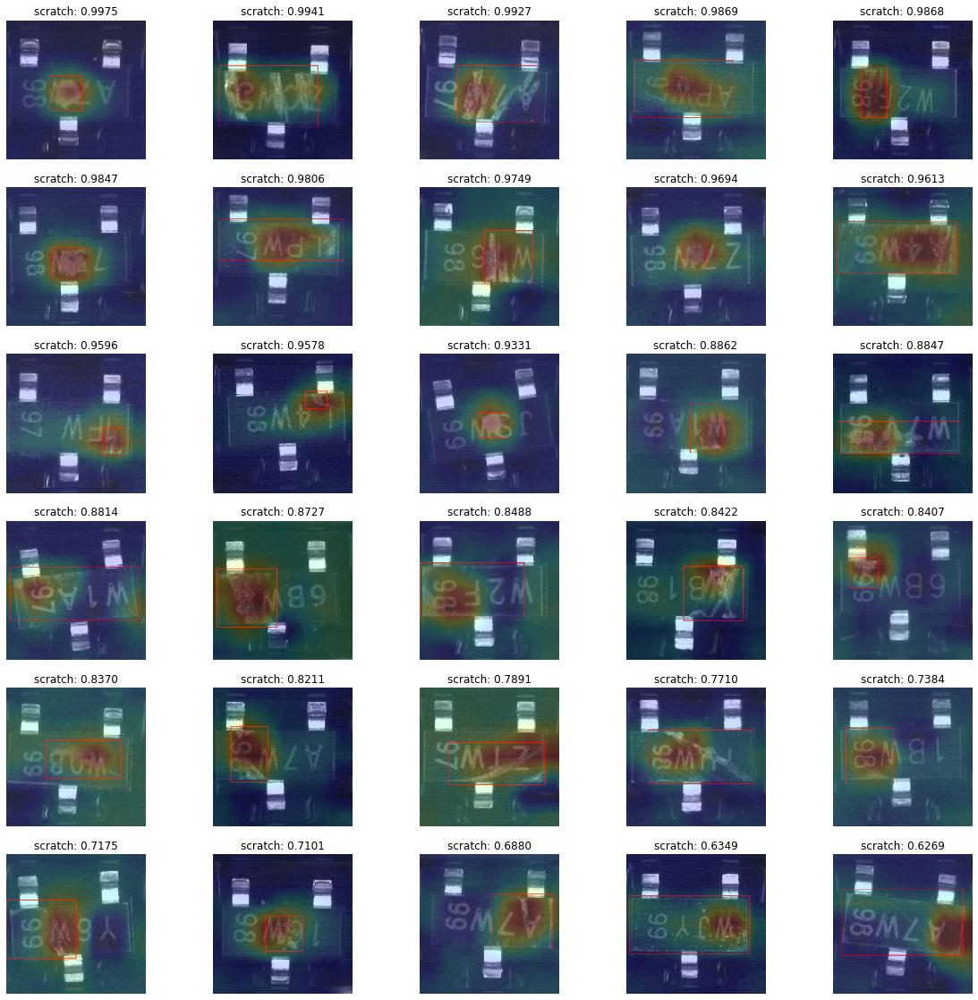

In [130]:
# scratch high
defect = 9

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

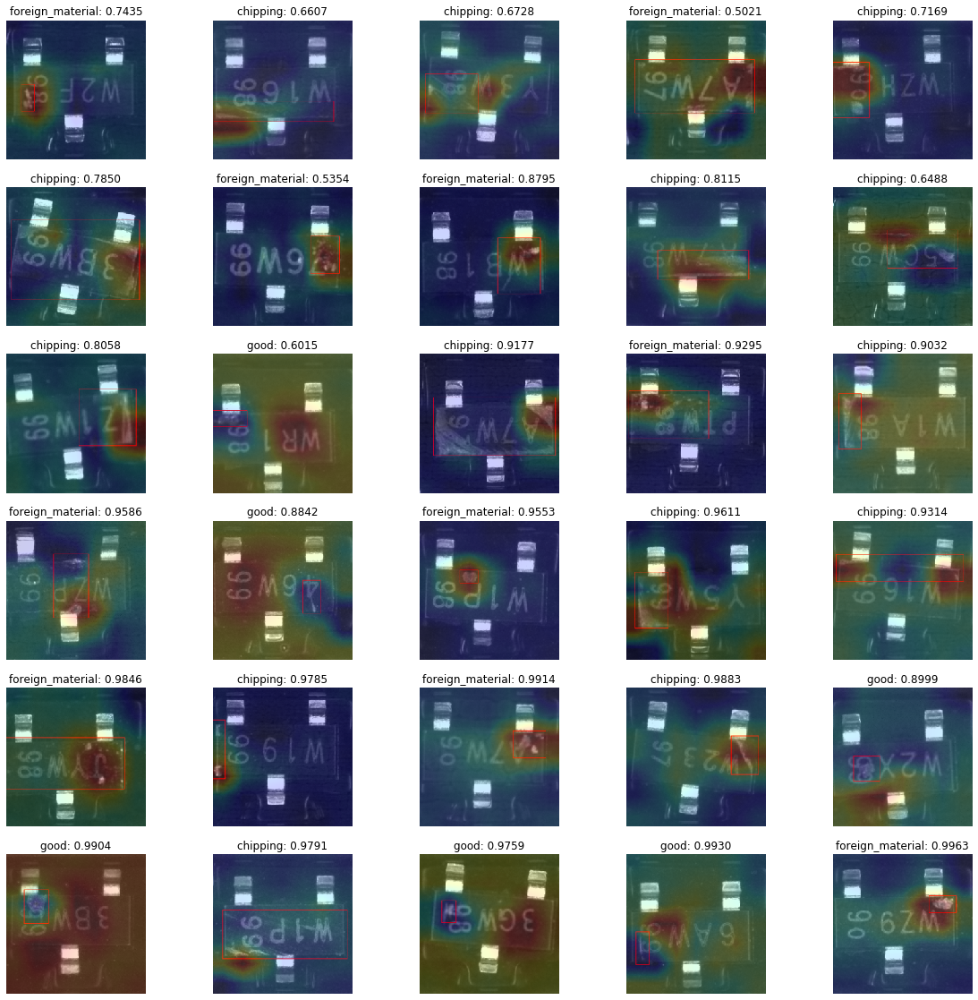

In [131]:
# scratch low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

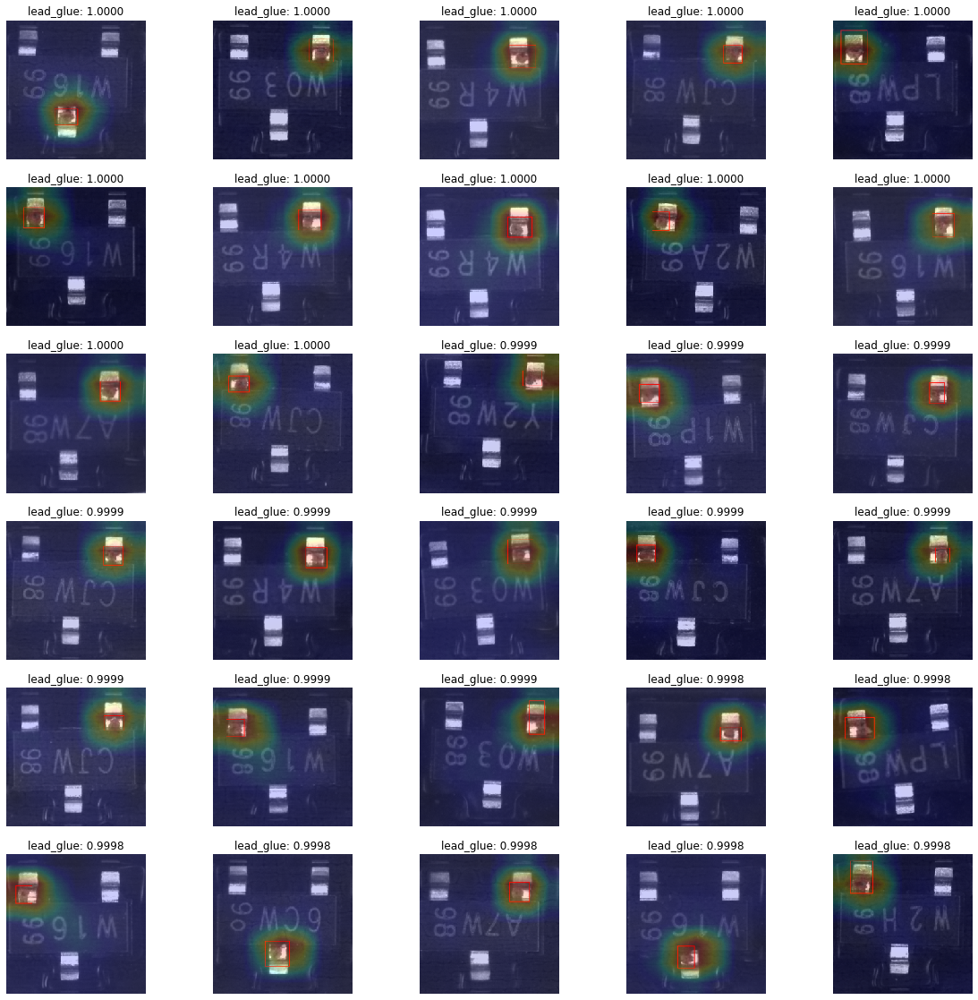

In [132]:
# lead glue high
defect = 6

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

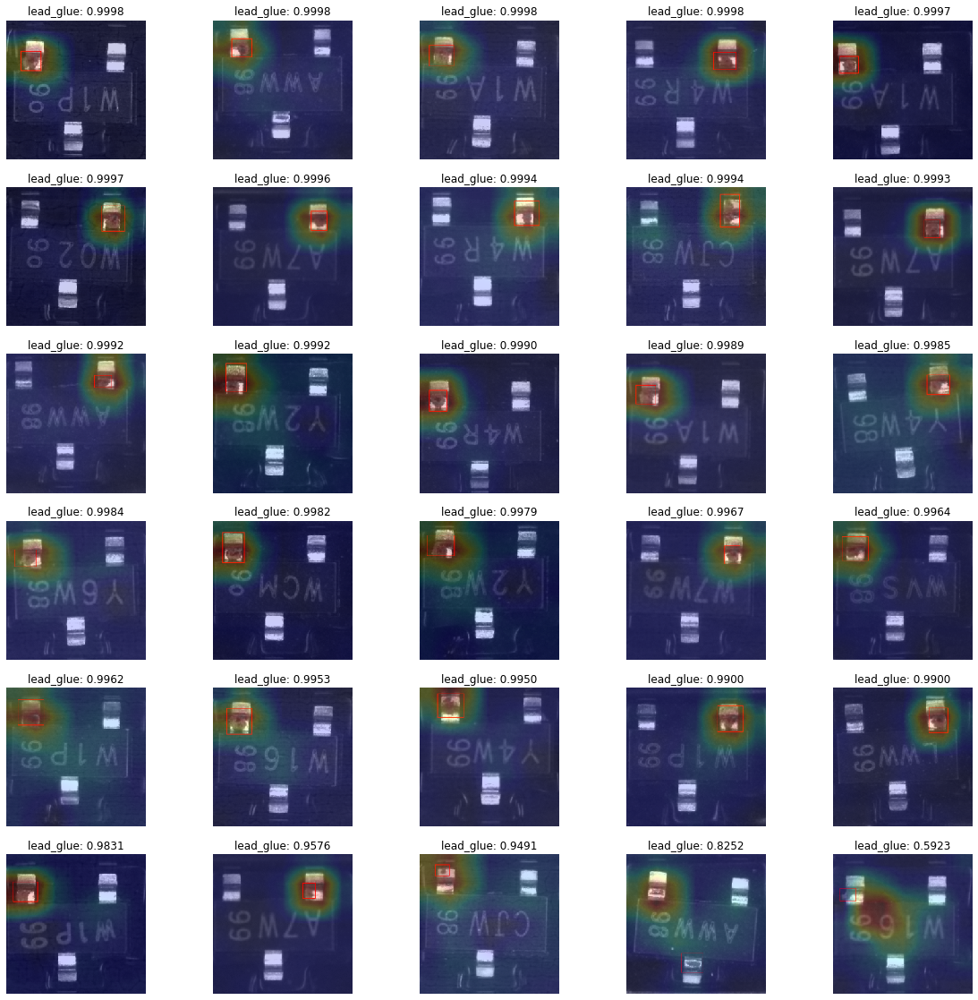

In [133]:
# lead glue low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

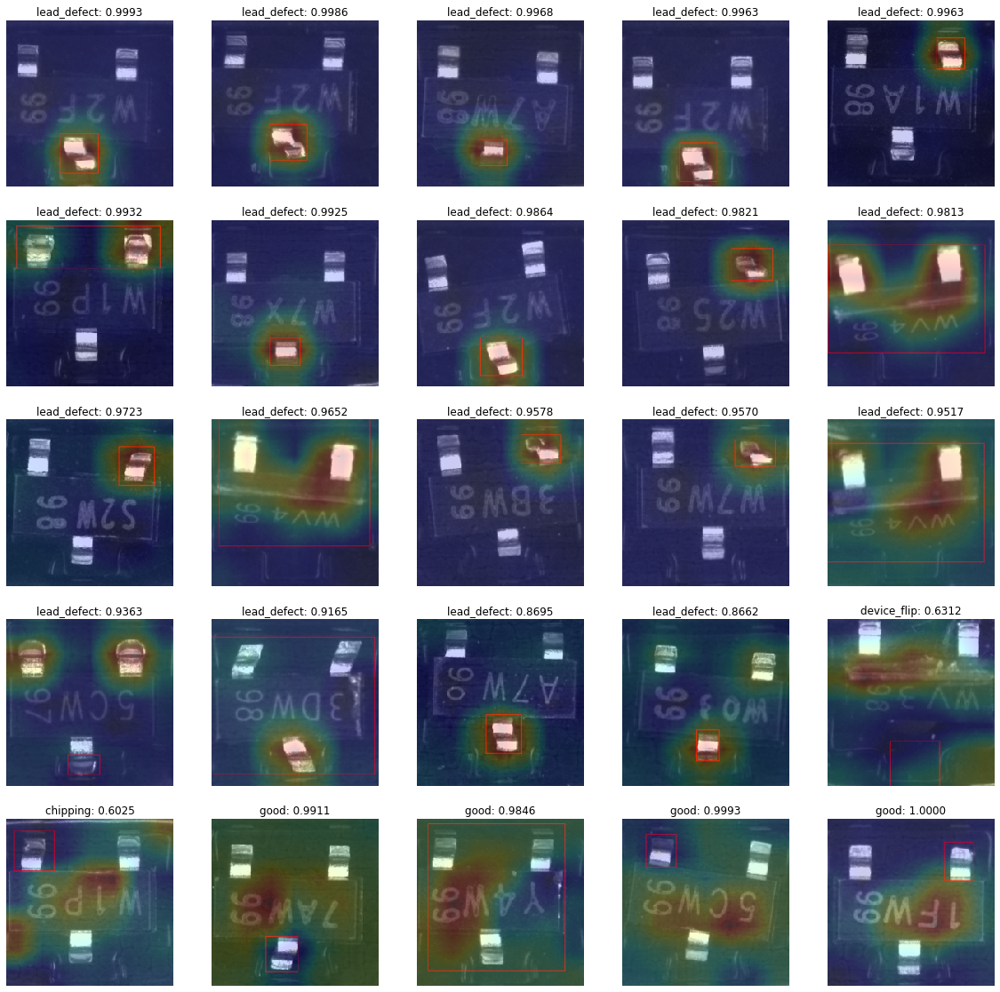

In [134]:
# lead defect

defect = 5

fig, axs = plt.subplots(5, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(25):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')

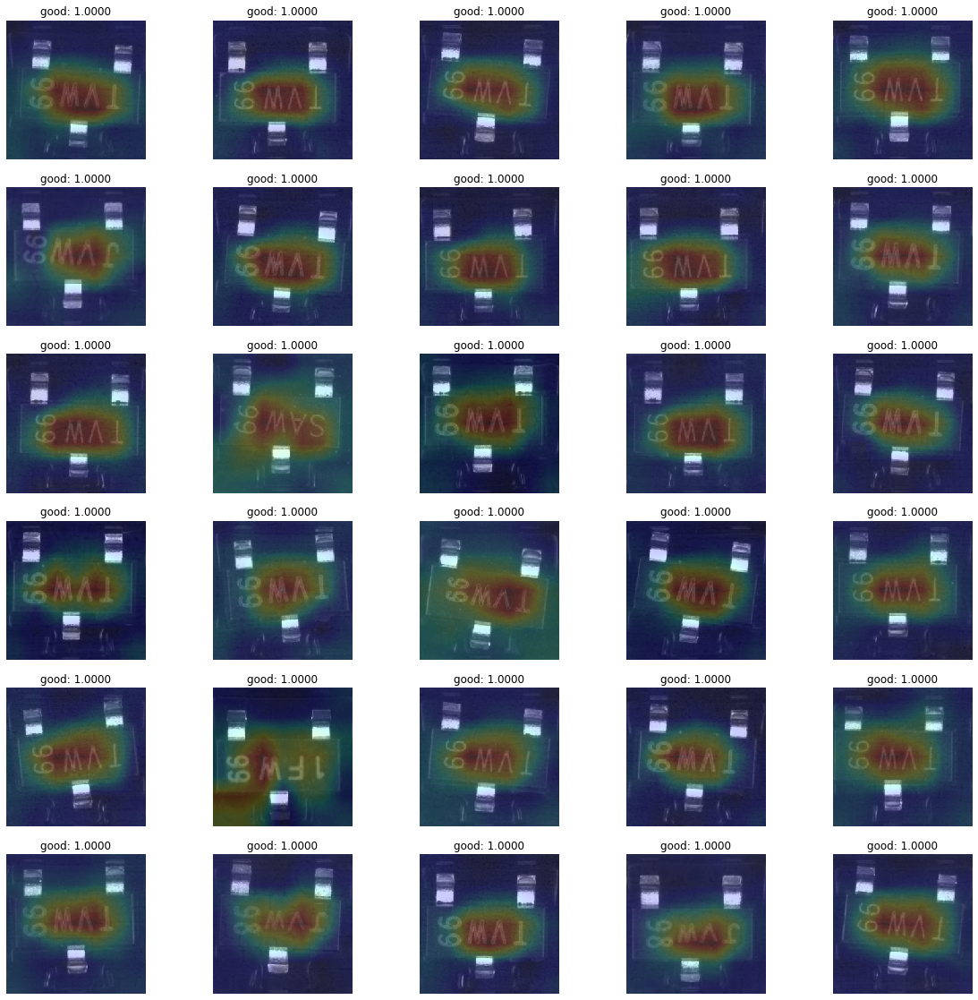

In [135]:
# good high
defect = 4

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191003_SOT23_PassImage', image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

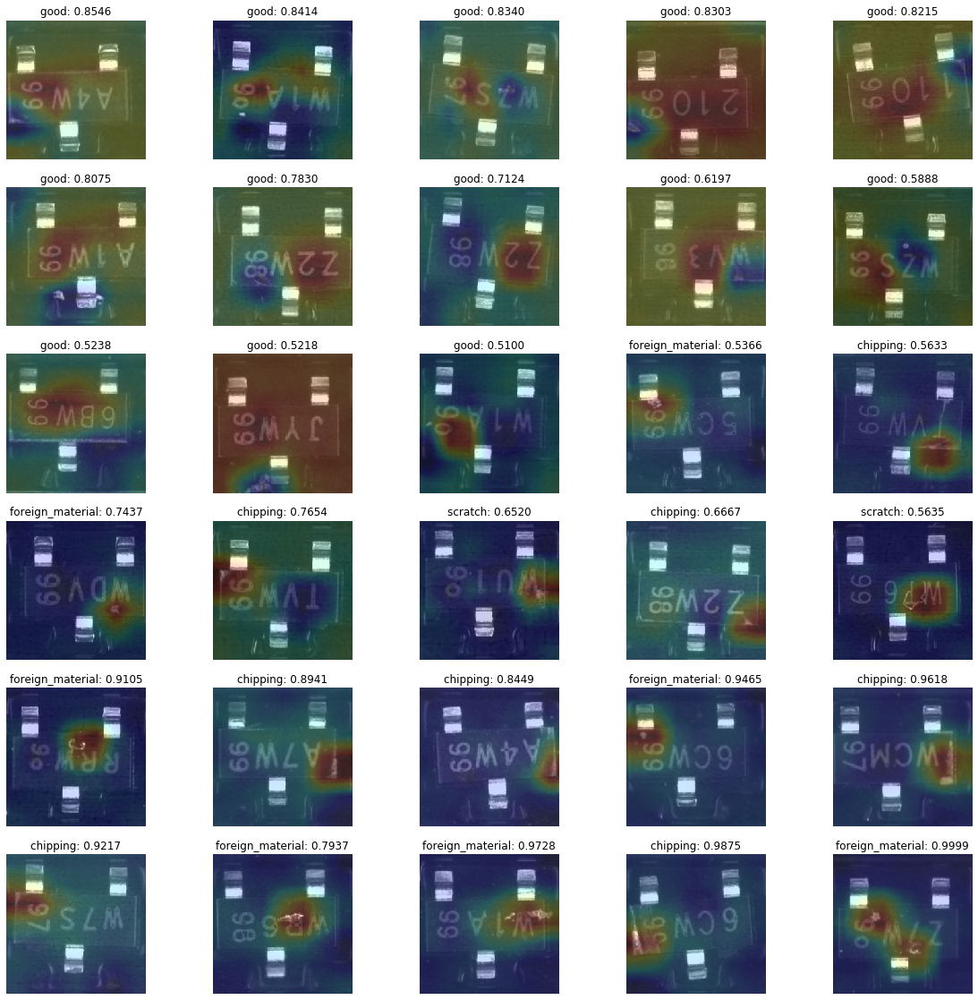

In [136]:
# good low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191003_SOT23_PassImage', image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

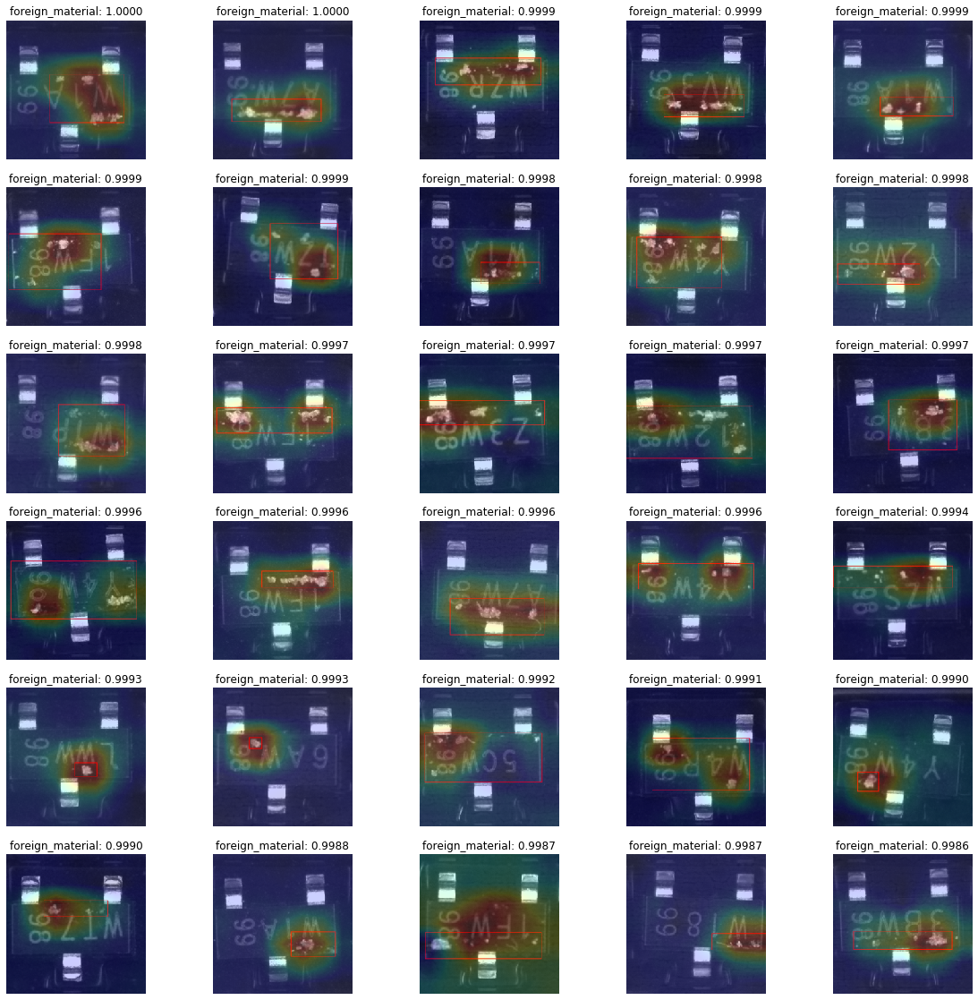

In [137]:
# foreign material high
defect = 3

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

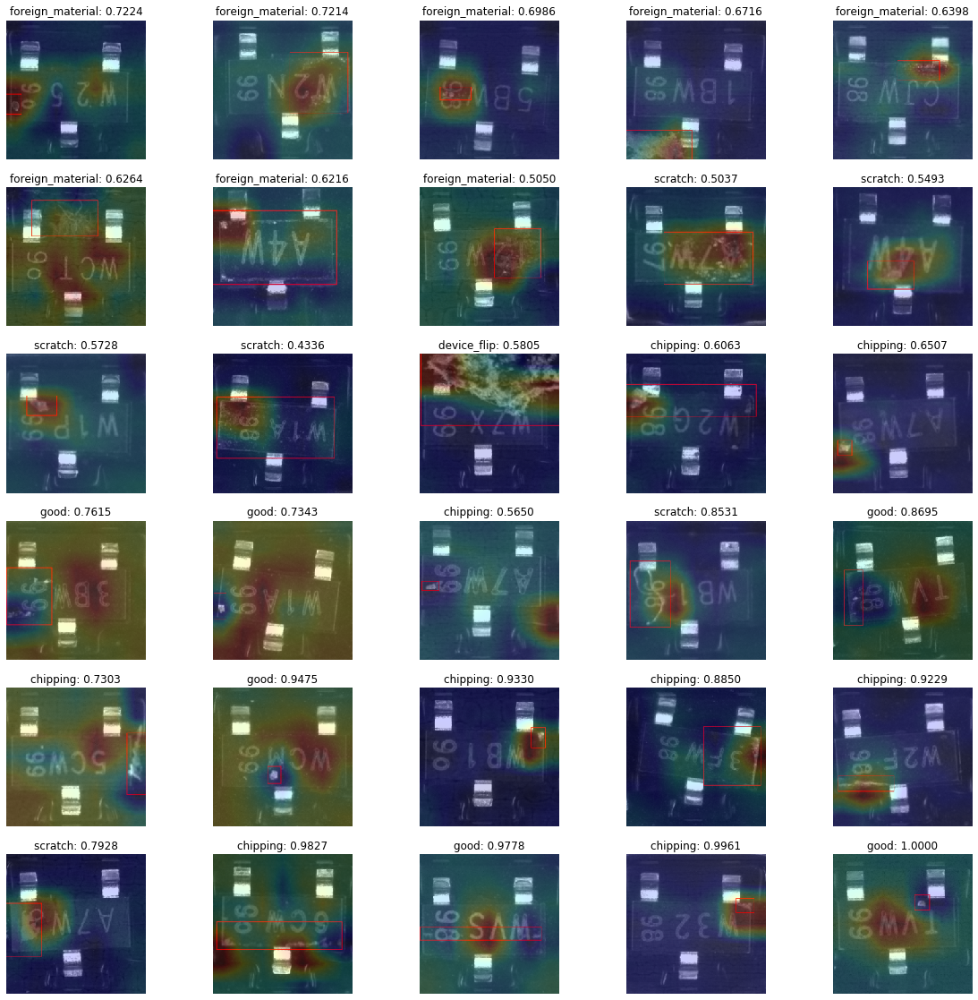

In [138]:
# foreign material low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

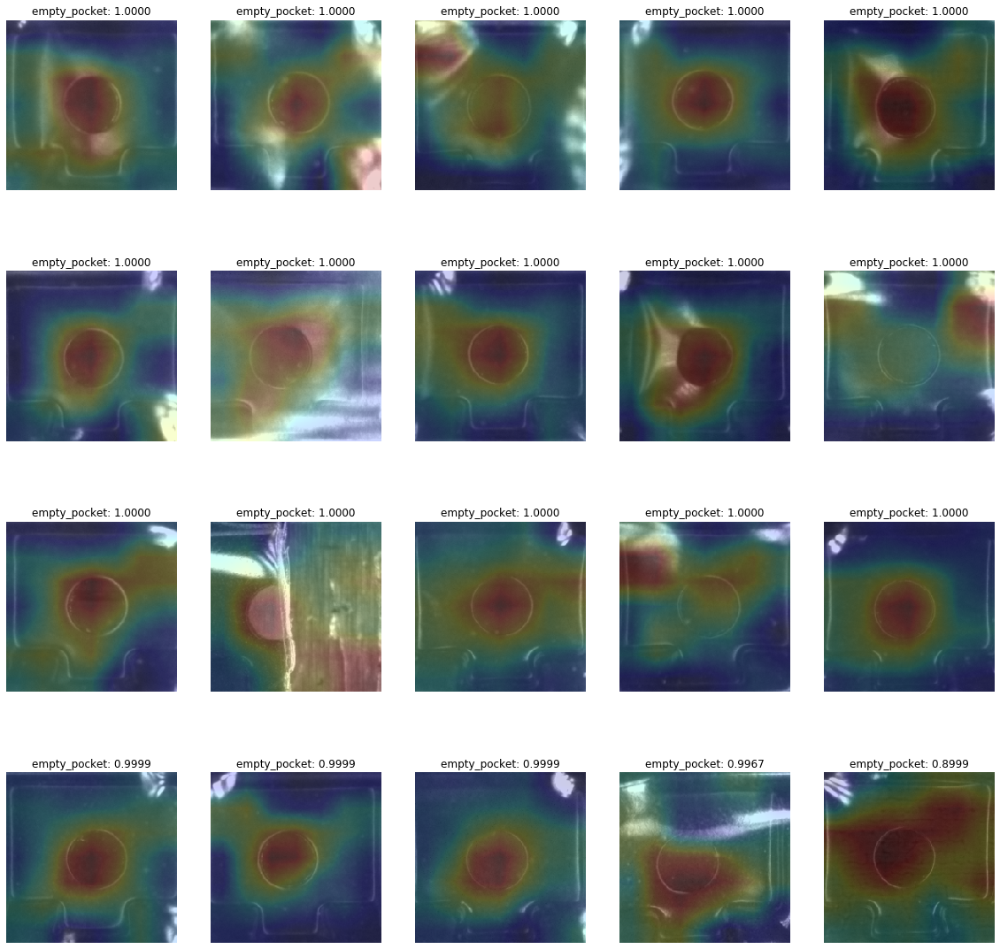

In [139]:
# empty pocket
defect = 2

fig, axs = plt.subplots(4, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(20):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')

(0.0, 1.0, 0.0, 1.0)

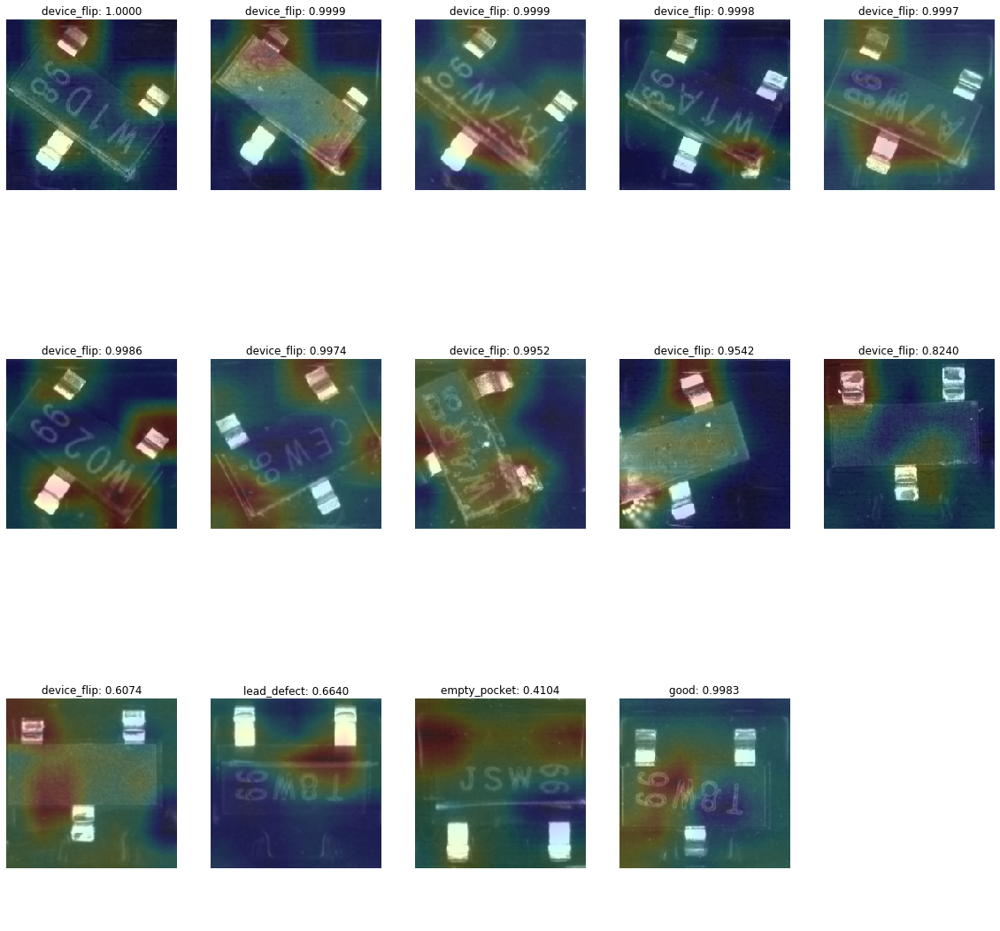

In [142]:
# device flip
defect = 1

fig, axs = plt.subplots(3, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(14):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')
axs[14].axis('off')

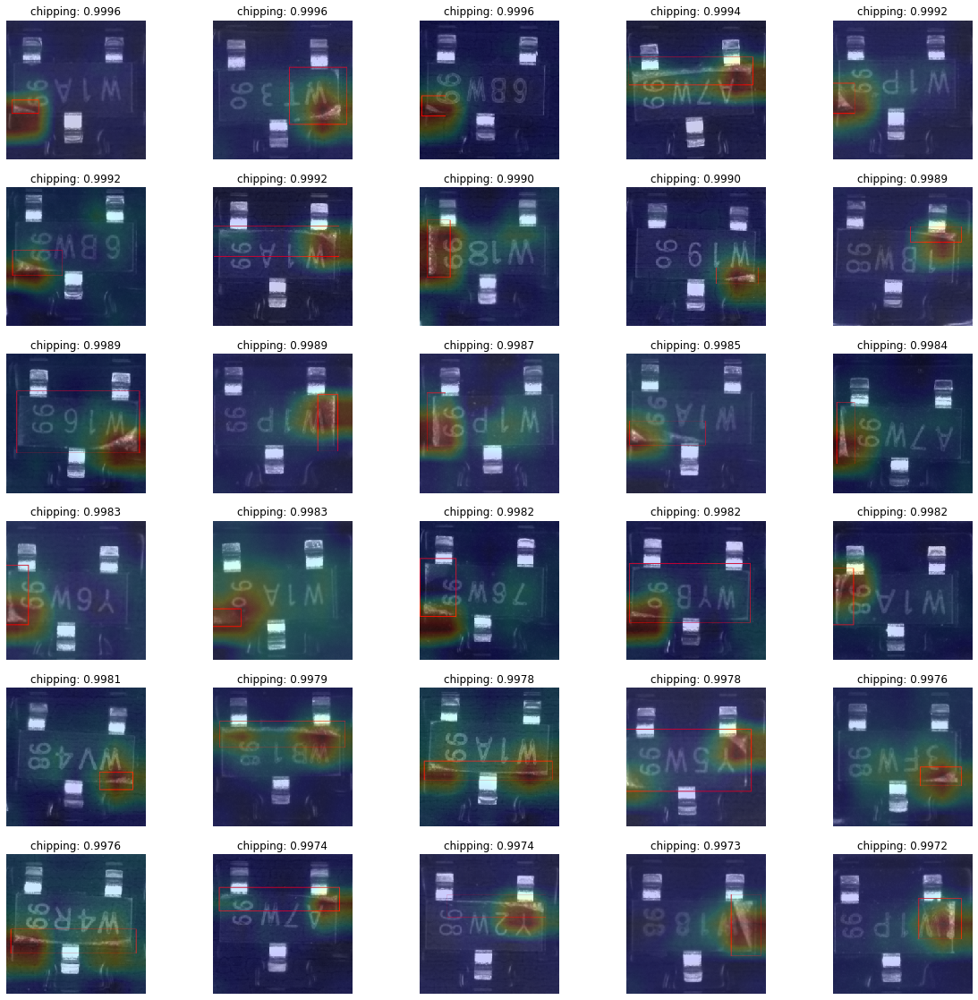

In [143]:
# chipping high
defect = 0

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

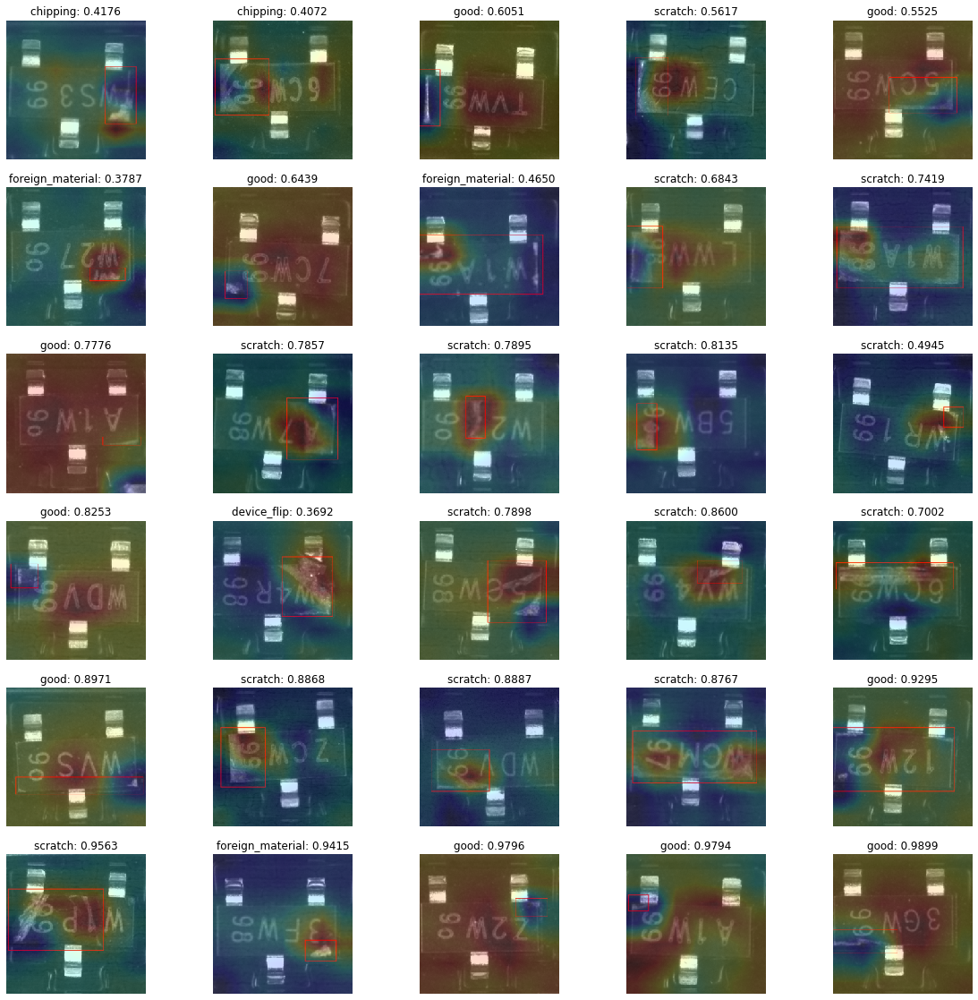

In [144]:
# chipping low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

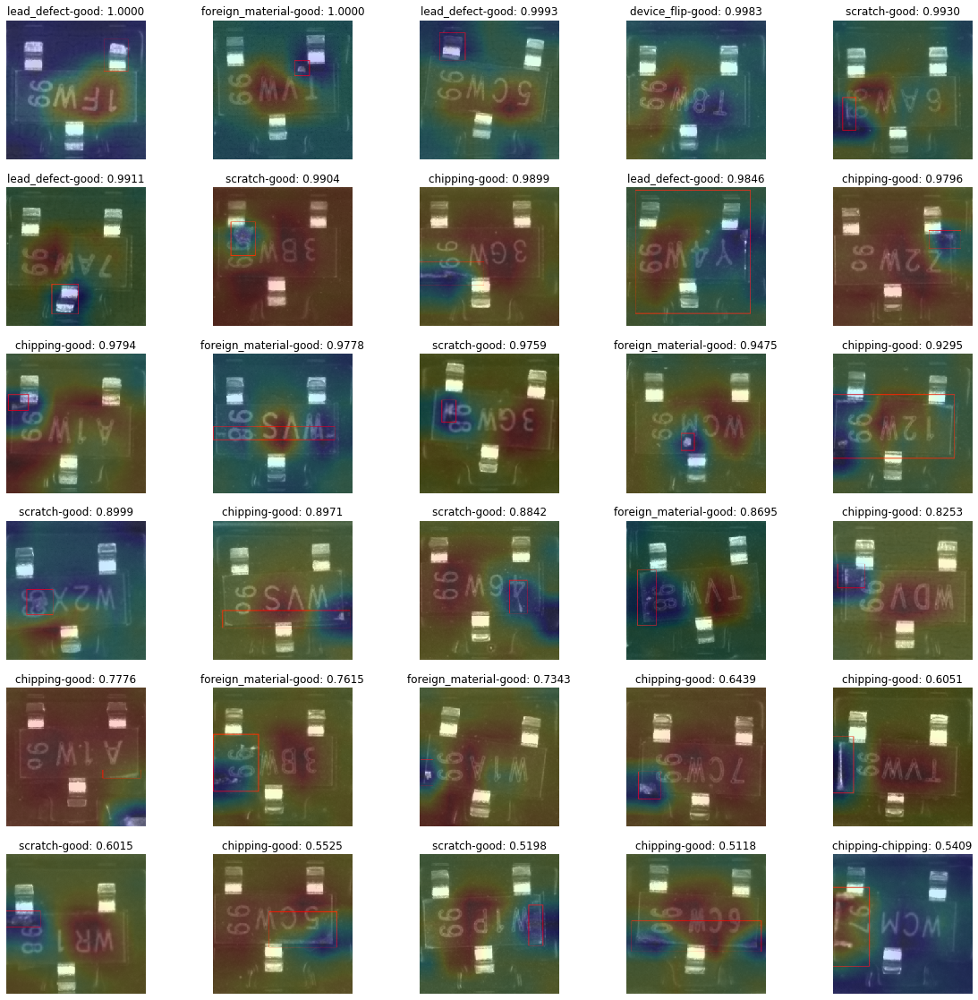

In [153]:
# bad low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[image_id_dict['bad_low_class'][i]], image_id_dict['bad_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    if image_id_dict['bad_low_class'][i] not in [1,2]:
        x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[image_id_dict['bad_low_class'][i]], image_id_dict['bad_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
        img = Image.open(image_path).convert('RGB')
        draw = ImageDraw.Draw(img)
        draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict['bad_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}-{}: {:.4f}'.format(class_names[image_id_dict['bad_low_class'][i]], class_names[torch.argmax(image_id_dict['bad_low_score'][i])], torch.max(image_id_dict['bad_low_score'][i])))
    axs[i].axis('off')

In [154]:
!nvidia-smi

Wed Sep 16 14:28:36 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.44       Driver Version: 440.44       CUDA Version: 10.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  GeForce GTX 108...  Off  | 00000000:02:00.0 Off |                  N/A |
|  0%   34C    P8    10W / 250W |   6734MiB / 11178MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   1  GeForce GTX 108...  Off  | 00000000:03:00.0 Off |                  N/A |
|  0%   28C    P8     8W / 250W |   8187MiB / 11178MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   2  G